## Capstone Project  :  Data Analysis of Credit Card Defaulters
### Nupoor Joshi    
#### RUID: 197001286


#### Main objective of the project 

Credit Card Defaults are the most common these days. The goal of this Capstone project is to carry out exploratory and predictive data analysis of the credit card holders based in the Taiwan region to predict the defaulters for the next month.
The factors that are taken into consideration are as follows :
1. Payment status for the months from April 2005 to September 2005.
2. Age
3. Gender
4. Education
5. Marriage
6. The due payments.


#### About the dataset:
This dataset contains information on default payments, demographic factors, credit data, history of payment, and bill statements of credit card clients in Taiwan from April 2005 to September 2005.

#### Features:
There are 25 features:

ID: ID of each client

LIMIT_BAL: Amount of given credit in NT dollars (includes individual and family/supplementary credit

SEX: Gender (1=male, 2=female)

EDUCATION: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)

MARRIAGE: Marital status (1=married, 2=single, 3=others)

AGE: Age in years

PAY_0: Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, ... 8=payment delay for eight months, 9=payment delay for nine months and above)

PAY_2: Repayment status in August, 2005 (scale same as above)

PAY_3: Repayment status in July, 2005 (scale same as above)

PAY_4: Repayment status in June, 2005 (scale same as above)

PAY_5: Repayment status in May, 2005 (scale same as above)

PAY_6: Repayment status in April, 2005 (scale same as above)

BILL_AMT1: Amount of bill statement in September, 2005 (NT dollar)

BILL_AMT2: Amount of bill statement in August, 2005 (NT dollar)

BILL_AMT3: Amount of bill statement in July, 2005 (NT dollar)

BILL_AMT4: Amount of bill statement in June, 2005 (NT dollar)

BILL_AMT5: Amount of bill statement in May, 2005 (NT dollar)

BILL_AMT6: Amount of bill statement in April, 2005 (NT dollar)

PAY_AMT1: Amount of previous payment in September, 2005 (NT dollar)

PAY_AMT2: Amount of previous payment in August, 2005 (NT dollar)

PAY_AMT3: Amount of previous payment in July, 2005 (NT dollar)

PAY_AMT4: Amount of previous payment in June, 2005 (NT dollar)

PAY_AMT5: Amount of previous payment in May, 2005 (NT dollar)

PAY_AMT6: Amount of previous payment in April, 2005 (NT dollar)

default.payment.next.month: Default payment (1=yes, 0=no)

Lets have a look at the dataset.

In [2]:
import numpy as np # linear algebra
import os # accessing directory structure
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns 
import matplotlib.pyplot as plt

In [3]:
import warnings
warnings.filterwarnings('ignore')

### 1. Importing and Analysing the data

In [4]:
creditdata = pd.read_csv("C:/Users/shrey/Desktop/Credit_card_project/Capstone/DA_Credit_Card.csv")
creditdata

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,Is Average greater than 10k and less than 30k,Is Average greater than 30k and less than 50k,Is Average greater than 50k and less than 70k,Is Average greater than 70k and less than 100k,DUE_1,DUE_2,DUE_3,DUE_4,DUE_5,DUE_6
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0,0,0,0,3913,2413,689,0,0,0
1,2,120000.0,2,2,2,26,-1,2,0,0,...,0,0,0,0,2682,725,1682,2272,3455,1261
2,3,90000.0,2,2,2,34,0,0,0,0,...,0,0,0,0,27721,12527,12559,13331,13948,10549
3,4,50000.0,2,2,1,37,0,0,0,0,...,0,0,0,0,44990,46214,48091,27214,27890,28547
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,0,0,0,0,6617,-31011,25835,11940,18457,18452
5,6,50000.0,1,1,2,37,0,0,0,0,...,0,1,0,0,61900,55254,56951,18394,18619,19224
6,7,500000.0,1,1,2,29,0,0,0,0,...,0,0,0,0,312965,372023,407007,522414,469253,460174
7,8,100000.0,2,2,2,23,0,-1,-1,0,...,0,0,0,0,11496,-221,601,-360,-1846,-975
8,9,140000.0,2,3,1,28,0,0,2,0,...,0,0,0,0,7956,14096,11676,11211,10793,2719
9,10,20000.0,1,3,2,35,-2,-2,-2,-2,...,0,0,0,0,0,0,0,-13007,11885,13912


In [5]:
creditdata.describe()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,Is Average greater than 10k and less than 30k,Is Average greater than 30k and less than 50k,Is Average greater than 50k and less than 70k,Is Average greater than 70k and less than 100k,DUE_1,DUE_2,DUE_3,DUE_4,DUE_5,DUE_6
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,...,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,3.000000e+04,3.000000e+04,30000.00000,30000.000000,30000.000000
mean,15000.500000,167484.322667,1.603733,1.853133,1.551867,35.485500,-0.016700,-0.133767,-0.166200,-0.220667,...,0.126500,0.009633,0.000400,0.000400,45559.750400,4.325791e+04,4.178747e+04,38436.87210,35512.013333,33656.257833
std,8660.398374,129747.661567,0.489129,0.790349,0.521970,9.217904,1.123802,1.197186,1.196868,1.169139,...,0.332418,0.097677,0.019996,0.019996,73173.789447,7.256594e+04,6.929536e+04,64200.61083,60553.370054,60151.290836
min,1.000000,10000.000000,1.000000,0.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,...,0.000000,0.000000,0.000000,0.000000,-733744.000000,-1.702347e+06,-8.546410e+05,-667000.00000,-414380.000000,-684896.000000
25%,7500.750000,50000.000000,1.000000,1.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,...,0.000000,0.000000,0.000000,0.000000,745.000000,3.295000e+02,2.627500e+02,230.00000,0.000000,0.000000
50%,15000.500000,140000.000000,2.000000,2.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,18550.500000,1.810250e+04,1.776900e+04,16970.00000,15538.000000,13926.500000
75%,22500.250000,240000.000000,2.000000,2.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,62241.500000,5.907775e+04,5.629425e+04,50259.50000,46961.500000,46067.250000
max,30000.000000,1000000.000000,2.000000,6.000000,3.000000,79.000000,8.000000,8.000000,8.000000,8.000000,...,1.000000,1.000000,1.000000,1.000000,913727.000000,9.332080e+05,1.542258e+06,841586.00000,877171.000000,911408.000000


In [6]:
creditdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 38 columns):
ID                                                30000 non-null int64
LIMIT_BAL                                         30000 non-null float64
SEX                                               30000 non-null int64
EDUCATION                                         30000 non-null int64
MARRIAGE                                          30000 non-null int64
AGE                                               30000 non-null int64
PAY_0                                             30000 non-null int64
PAY_2                                             30000 non-null int64
PAY_3                                             30000 non-null int64
PAY_4                                             30000 non-null int64
PAY_5                                             30000 non-null int64
PAY_6                                             30000 non-null int64
BILL_AMT1                            

### 2. Data Preprocesssing

##### Checking the data for null values.

In [7]:
cdata = creditdata.isnull().sum()
cdata

ID                                                0
LIMIT_BAL                                         0
SEX                                               0
EDUCATION                                         0
MARRIAGE                                          0
AGE                                               0
PAY_0                                             0
PAY_2                                             0
PAY_3                                             0
PAY_4                                             0
PAY_5                                             0
PAY_6                                             0
BILL_AMT1                                         0
BILL_AMT2                                         0
BILL_AMT3                                         0
BILL_AMT4                                         0
BILL_AMT5                                         0
BILL_AMT6                                         0
PAY_AMT1                                          0
PAY_AMT2    

##### The dataset has no null values, just certain columns have to be renamed i.e data transformation is to be done.

In [8]:
new_data = pd.DataFrame(creditdata)
new_data

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,Is Average greater than 10k and less than 30k,Is Average greater than 30k and less than 50k,Is Average greater than 50k and less than 70k,Is Average greater than 70k and less than 100k,DUE_1,DUE_2,DUE_3,DUE_4,DUE_5,DUE_6
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0,0,0,0,3913,2413,689,0,0,0
1,2,120000.0,2,2,2,26,-1,2,0,0,...,0,0,0,0,2682,725,1682,2272,3455,1261
2,3,90000.0,2,2,2,34,0,0,0,0,...,0,0,0,0,27721,12527,12559,13331,13948,10549
3,4,50000.0,2,2,1,37,0,0,0,0,...,0,0,0,0,44990,46214,48091,27214,27890,28547
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,0,0,0,0,6617,-31011,25835,11940,18457,18452
5,6,50000.0,1,1,2,37,0,0,0,0,...,0,1,0,0,61900,55254,56951,18394,18619,19224
6,7,500000.0,1,1,2,29,0,0,0,0,...,0,0,0,0,312965,372023,407007,522414,469253,460174
7,8,100000.0,2,2,2,23,0,-1,-1,0,...,0,0,0,0,11496,-221,601,-360,-1846,-975
8,9,140000.0,2,3,1,28,0,0,2,0,...,0,0,0,0,7956,14096,11676,11211,10793,2719
9,10,20000.0,1,3,2,35,-2,-2,-2,-2,...,0,0,0,0,0,0,0,-13007,11885,13912


In [9]:
new_data = new_data.rename(columns = {'PAY_0':'PAY_1','default.payment.next.month':'default'})

In [10]:
new_data.dtypes

ID                                                  int64
LIMIT_BAL                                         float64
SEX                                                 int64
EDUCATION                                           int64
MARRIAGE                                            int64
AGE                                                 int64
PAY_1                                               int64
PAY_2                                               int64
PAY_3                                               int64
PAY_4                                               int64
PAY_5                                               int64
PAY_6                                               int64
BILL_AMT1                                         float64
BILL_AMT2                                         float64
BILL_AMT3                                         float64
BILL_AMT4                                         float64
BILL_AMT5                                         float64
BILL_AMT6     

In [11]:
conda install -c plotly plotly=4.10.0

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\ProgramData\Anaconda3

  added / updated specs:
    - plotly=4.10.0


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    ca-certificates-2020.12.8  |       haa95532_0         122 KB
    certifi-2020.12.5          |   py37haa95532_0         141 KB
    ------------------------------------------------------------
                                           Total:         262 KB

The following packages will be UPDATED:

  ca-certificates                               2020.7.22-0 --> 2020.12.8-haa95532_0
  certifi                                  2020.6.20-py37_0 --> 2020.12.5-py37haa95532_0
  conda                                        4.8.5-py37_0 --> 4.9.2-py37haa95532_0




certifi-2020.12.5    | 141 KB    |            |   0% 
certifi-2020.12.5    | 141 KB    | #1         |  11% 
certifi-2020.12.5    | 14


EnvironmentNotWritableError: The current user does not have write permissions to the target environment.
  environment location: C:\ProgramData\Anaconda3




In [12]:
#gendertype = {'1': 'Male','2':'Female'}
#new_data.SEX = new_data.loc[new_data.SEX == '1','gender'] = 'Male'
#new_data.SEX = new_data.loc[new_data.SEX == '2','gender'] = 'Female'

new_data['gender'] = new_data['SEX'].apply(lambda x: 'Male' if x == 1 else 'Female')

new_data.dtypes

new_data.gender = new_data['gender'].astype('category')
#new_data.EDUCATION = new_data['EDUCATION'].astype('category')
new_data.dtypes

ID                                                   int64
LIMIT_BAL                                          float64
SEX                                                  int64
EDUCATION                                            int64
MARRIAGE                                             int64
AGE                                                  int64
PAY_1                                                int64
PAY_2                                                int64
PAY_3                                                int64
PAY_4                                                int64
PAY_5                                                int64
PAY_6                                                int64
BILL_AMT1                                          float64
BILL_AMT2                                          float64
BILL_AMT3                                          float64
BILL_AMT4                                          float64
BILL_AMT5                                          float

In [13]:
cdata = new_data
cdata

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,...,Is Average greater than 30k and less than 50k,Is Average greater than 50k and less than 70k,Is Average greater than 70k and less than 100k,DUE_1,DUE_2,DUE_3,DUE_4,DUE_5,DUE_6,gender
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0,0,0,3913,2413,689,0,0,0,Female
1,2,120000.0,2,2,2,26,-1,2,0,0,...,0,0,0,2682,725,1682,2272,3455,1261,Female
2,3,90000.0,2,2,2,34,0,0,0,0,...,0,0,0,27721,12527,12559,13331,13948,10549,Female
3,4,50000.0,2,2,1,37,0,0,0,0,...,0,0,0,44990,46214,48091,27214,27890,28547,Female
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,0,0,0,6617,-31011,25835,11940,18457,18452,Male
5,6,50000.0,1,1,2,37,0,0,0,0,...,1,0,0,61900,55254,56951,18394,18619,19224,Male
6,7,500000.0,1,1,2,29,0,0,0,0,...,0,0,0,312965,372023,407007,522414,469253,460174,Male
7,8,100000.0,2,2,2,23,0,-1,-1,0,...,0,0,0,11496,-221,601,-360,-1846,-975,Female
8,9,140000.0,2,3,1,28,0,0,2,0,...,0,0,0,7956,14096,11676,11211,10793,2719,Female
9,10,20000.0,1,3,2,35,-2,-2,-2,-2,...,0,0,0,0,0,0,-13007,11885,13912,Male


In [14]:
new_data.PAY_1 = new_data['PAY_1'].astype('category')
new_data.PAY_2 = new_data['PAY_2'].astype('category')
new_data.PAY_3 = new_data['PAY_3'].astype('category')
new_data.PAY_4 = new_data['PAY_4'].astype('category')
new_data.PAY_5 = new_data['PAY_5'].astype('category')
new_data.PAY_6 = new_data['PAY_6'].astype('category')
new_data
cdata = new_data.drop(columns=['ID','SEX','EDUCATION','MARRIAGE'])
cdata.dtypes

LIMIT_BAL                                          float64
AGE                                                  int64
PAY_1                                             category
PAY_2                                             category
PAY_3                                             category
PAY_4                                             category
PAY_5                                             category
PAY_6                                             category
BILL_AMT1                                          float64
BILL_AMT2                                          float64
BILL_AMT3                                          float64
BILL_AMT4                                          float64
BILL_AMT5                                          float64
BILL_AMT6                                          float64
PAY_AMT1                                           float64
PAY_AMT2                                           float64
PAY_AMT3                                           float

### 3. Exploratory Data Analysis(EDA)

In [15]:
gdata = cdata.groupby('default').mean()
gdata

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,...,Is Average greater than 10k and less than 30k,Is Average greater than 30k and less than 50k,Is Average greater than 50k and less than 70k,Is Average greater than 70k and less than 100k,DUE_1,DUE_2,DUE_3,DUE_4,DUE_5,DUE_6
default,,,,,,,,,,,,,,,,,,,,,
0,178099.726074,35.417266,51994.227273,49717.435670,47533.365605,43611.165254,40530.445343,39042.268704,6307.337357,6640.465074,...,0.130671,0.009673,0.000428,0.000428,45686.889916,43076.970596,41779.868772,38310.635936,35282.225047,33322.896935
1,130109.656420,35.725738,48509.162297,47283.617842,45181.598855,42036.950573,39540.190476,38271.435503,3397.044153,3388.649638,...,0.111814,0.009494,0.000301,0.000301,45112.118143,43894.968204,41814.247288,38881.323840,36321.050934,34829.953436


In [16]:
mdata  = cdata.groupby('Number of missed payments').mean()
mdata

,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,...,Is Average greater than 10k and less than 30k,Is Average greater than 30k and less than 50k,Is Average greater than 50k and less than 70k,Is Average greater than 70k and less than 100k,DUE_1,DUE_2,DUE_3,DUE_4,DUE_5,DUE_6
Number of missed payments,,,,,,,,,,,,,,,,,,,,,
0,187259.429030,35.617731,55865.757664,52762.414831,49905.399127,45262.176158,41552.864733,40013.162059,6682.669209,7153.626160,...,0.139481,0.009583,0.000552,0.000552,49183.088455,45608.788671,43639.297125,39555.829963,35795.038081,33779.852742
1,158388.160868,35.368504,31428.314731,32340.346814,31464.131270,29475.949390,28272.415273,26796.337325,4971.456620,4190.661771,...,0.074559,0.010167,0.000000,0.000000,26456.858111,28149.685043,27793.322865,25960.255310,25218.136014,23544.760958
2,122588.730911,35.135861,49409.147973,46628.569774,45410.511322,41875.143760,39460.458136,38316.344392,2543.404423,3867.588731,...,0.110058,0.009479,0.000000,0.000000,46865.743549,42760.981043,41881.339126,38578.436546,35898.720906,34620.944181
3,105173.310225,34.893414,50128.248700,49836.857019,47377.491334,44834.544194,42374.305893,40078.729636,2736.154246,2074.029463,...,0.115251,0.007799,0.000000,0.000000,47392.094454,47762.827556,44236.995667,41942.696707,39655.598787,36915.093588
4,87392.218717,34.544690,47055.627760,48070.781283,48194.715037,46463.386961,44855.863302,44531.368034,2906.318612,2863.839117,...,0.118822,0.009464,0.000000,0.000000,44149.309148,45206.942166,46445.375394,43744.176656,42492.286015,41801.973712
5,93422.818792,35.053691,53804.167785,53789.268456,53151.117450,52168.734899,49115.006711,46571.020134,2244.453020,2247.459732,...,0.137584,0.006711,0.000000,0.000000,51559.714765,51541.808725,50625.261745,51226.060403,46437.567114,42145.604027
6,94049.217002,35.674124,53451.360925,54304.465324,55100.295302,55417.269202,55845.350485,55785.833706,2454.336316,2518.178971,...,0.140940,0.011186,0.000746,0.000746,50997.024609,51786.286353,52944.134974,53162.136465,53789.138702,53358.777032


### Defaulters by Gender


In [17]:
import plotly.express as px

In [18]:
data = px.data.tips()
fig = px.histogram(new_data, x="gender", color='default')
fig.update_xaxes(
    constrain="domain", 
    categoryorder = "total descending"
    # meanwhile compresses the xaxis by decreasing its "domain"
)
fig.show()

#### The number of female defaulters are much higher in comparision to male defaulters within the dataset.

### Defaulters by education level

In [19]:
new_data.loc[(new_data['EDUCATION'] == 0) | (new_data['EDUCATION'] == 5)|(new_data['EDUCATION'] == 6),'EDUCATION'] = 4
new_data
new_data.EDUCATION = new_data['EDUCATION'].astype('category')
new_data.dtypes
new_data.EDUCATION.unique()


[2, 1, 3, 4]
Categories (4, int64): [2, 1, 3, 4]

In [20]:
education_level = {1:'Graduate School',2:'University',3:'High School',4:'Others'}
new_data['Education_level']= new_data['EDUCATION'].map(education_level)
new_data.dtypes


ID                                                   int64
LIMIT_BAL                                          float64
SEX                                                  int64
EDUCATION                                         category
MARRIAGE                                             int64
AGE                                                  int64
PAY_1                                             category
PAY_2                                             category
PAY_3                                             category
PAY_4                                             category
PAY_5                                             category
PAY_6                                             category
BILL_AMT1                                          float64
BILL_AMT2                                          float64
BILL_AMT3                                          float64
BILL_AMT4                                          float64
BILL_AMT5                                          float

In [21]:
data = px.data.tips()
fig = px.histogram(new_data, x="Education_level", color='default',histnorm = 'percent')
fig.update_xaxes(
    range=[0,4],  # sets the range of xaxis
    constrain="domain", 
    categoryorder = "total descending"
    # meanwhile compresses the xaxis by decreasing its "domain"
)
fig.show()

### Distribution of credit balance by age and gender

In [22]:
import plotly.express as px
df = px.data.tips()
fig = px.histogram(new_data, x="AGE", y="LIMIT_BAL",color = 'gender', histfunc='avg',nbins = 10)
fig.update_layout(
    title="Age vs Credit Balance",
    xaxis_title="AGE",
    yaxis_title="Average Credit Given")
fig.show()

#### The age group 70-79 has the highest credit balance followed by the age group 30-39.

### Distribution of  defaulters by marriage status


In [23]:
new_data.MARRIAGE.unique()
new_data.loc[(new_data['MARRIAGE'] == 0),'MARRIAGE'] = 3
new_data
new_data.MARRIAGE = new_data['MARRIAGE'].astype('category')
new_data.MARRIAGE.unique()

[1, 2, 3]
Categories (3, int64): [1, 2, 3]

In [24]:
marriage_status = {1:'Single',2:'Married',3:'Others'}
new_data['Marriage_status']= new_data['MARRIAGE'].map(marriage_status)
new_data.dtypes

ID                                                   int64
LIMIT_BAL                                          float64
SEX                                                  int64
EDUCATION                                         category
MARRIAGE                                          category
AGE                                                  int64
PAY_1                                             category
PAY_2                                             category
PAY_3                                             category
PAY_4                                             category
PAY_5                                             category
PAY_6                                             category
BILL_AMT1                                          float64
BILL_AMT2                                          float64
BILL_AMT3                                          float64
BILL_AMT4                                          float64
BILL_AMT5                                          float

In [25]:
data = px.data.tips()
fig = px.histogram(new_data, x="Marriage_status", color='default')
fig.update_xaxes(
    categoryorder = "total descending"
)
fig.update_layout(
    title=" Credit defaulters by marriage status of clients ")
fig.show()

#### Credit deafaulters are much higher among people with married status in comparision to single people for the given dataset.

### Credit balance distribution by education level

In [26]:
import plotly.express as px
df = px.data.tips()
fig = px.pie(new_data, values='LIMIT_BAL', names='Education_level', color_discrete_sequence=px.colors.diverging.Spectral)
fig.update_layout(
    title=" Given Credit distribution by Education level of Clients ")
fig.show()

#### From the visualization, it can be concluded that graduate level students have maximum credit amounts associated with their accounts.

In [27]:
new_data.dtypes

ID                                                   int64
LIMIT_BAL                                          float64
SEX                                                  int64
EDUCATION                                         category
MARRIAGE                                          category
AGE                                                  int64
PAY_1                                             category
PAY_2                                             category
PAY_3                                             category
PAY_4                                             category
PAY_5                                             category
PAY_6                                             category
BILL_AMT1                                          float64
BILL_AMT2                                          float64
BILL_AMT3                                          float64
BILL_AMT4                                          float64
BILL_AMT5                                          float

### Payment status distribution of September 2005

#### Converting education data to category type

In [28]:
ldata = pd.DataFrame(list(new_data['Number of missed payments']))
ldata.columns = ['Missed_payments']
ldata.loc[(ldata['Missed_payments'] < 0),'Missed_payments'] = 0
ldata.Missed_payments.unique()
ldata.Missed_payments = ldata['Missed_payments'].astype('category')
delay_status = {0:'Pay duly',1:'One_month',2:'Two_month',3:'Three_month',4:'Four_month',5:'Five_month',6:'Six_month',-1:'Pay duly'}
ldata['Missed_payments']= ldata['Missed_payments'].map(delay_status)
ldata['default'] = new_data['default']
ldata

,Missed_payments,default
0,Two_month,1
1,Two_month,1
2,Pay duly,0
3,Pay duly,0
4,Pay duly,0
5,Pay duly,0
6,Pay duly,0
7,Pay duly,0
8,One_month,0
9,Pay duly,0


In [29]:
data = px.data.tips()
fig = px.histogram(ldata, x="Missed_payments", color = "default")
fig.update_xaxes(
    categoryorder = "total descending"
)
fig.update_layout(
    title=" Payment_delay ")
fig.show()

In [30]:
new_data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 41 columns):
ID                                                30000 non-null int64
LIMIT_BAL                                         30000 non-null float64
SEX                                               30000 non-null int64
EDUCATION                                         30000 non-null category
MARRIAGE                                          30000 non-null category
AGE                                               30000 non-null int64
PAY_1                                             30000 non-null category
PAY_2                                             30000 non-null category
PAY_3                                             30000 non-null category
PAY_4                                             30000 non-null category
PAY_5                                             30000 non-null category
PAY_6                                             30000 non-null category
BILL_AMT1    

In [31]:
# Plotting heat maps along with the correlation values
plt.figure(figsize=(400,300))
cor = cdata.corr()
sns.set(font_scale=16)
sns.heatmap(cor, annot=True,annot_kws={"size": 150},vmax=.9, square=True,cmap = 'RdYlGn')
plt.show()

In [32]:
sdata = new_data.drop(new_data.columns[[1,28,29,30,31]], axis = 1)
sdata

,ID,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,Is Average Bill Amount less than 10K?,DUE_1,DUE_2,DUE_3,DUE_4,DUE_5,DUE_6,gender,Education_level,Marriage_status
0,1,2,2,1,24,2,2,-1,-1,-2,...,1,3913,2413,689,0,0,0,Female,University,Single
1,2,2,2,2,26,-1,2,0,0,0,...,1,2682,725,1682,2272,3455,1261,Female,University,Married
2,3,2,2,2,34,0,0,0,0,0,...,1,27721,12527,12559,13331,13948,10549,Female,University,Married
3,4,2,2,1,37,0,0,0,0,0,...,1,44990,46214,48091,27214,27890,28547,Female,University,Single
4,5,1,2,1,57,-1,0,-1,0,0,...,1,6617,-31011,25835,11940,18457,18452,Male,University,Single
5,6,1,1,2,37,0,0,0,0,0,...,1,61900,55254,56951,18394,18619,19224,Male,Graduate School,Married
6,7,1,1,2,29,0,0,0,0,0,...,0,312965,372023,407007,522414,469253,460174,Male,Graduate School,Married
7,8,2,2,2,23,0,-1,-1,0,0,...,1,11496,-221,601,-360,-1846,-975,Female,University,Married
8,9,2,3,1,28,0,0,2,0,0,...,1,7956,14096,11676,11211,10793,2719,Female,High School,Single
9,10,1,3,2,35,-2,-2,-2,-2,-1,...,1,0,0,0,-13007,11885,13912,Male,High School,Married


In [33]:
xdata = sdata.drop(columns = {'ID','Education_level','Marriage_status','default','PAY_1','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6','DUE_1','Average Bill Amount (TD)'})
xdata.loc[(xdata['MARRIAGE'] == 0),'MARRIAGE'] = 3
xdata.loc[(xdata['EDUCATION'] == 0) | (xdata['EDUCATION'] == 5)|(xdata['EDUCATION'] == 6),'EDUCATION'] = 4
xdata = xdata.drop(columns = {'gender'})
xdata.head()

,SEX,EDUCATION,MARRIAGE,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,...,PAY_AMT4,PAY_AMT5,PAY_AMT6,Number of missed payments,Is Average Bill Amount less than 10K?,DUE_2,DUE_3,DUE_4,DUE_5,DUE_6
0,2,2,1,24,3913.0,3102.0,689.0,0.0,0.0,0.0,...,0.0,0.0,0.0,2,1,2413,689,0,0,0
1,2,2,2,26,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,...,1000.0,0.0,2000.0,2,1,725,1682,2272,3455,1261
2,2,2,2,34,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,...,1000.0,1000.0,5000.0,0,1,12527,12559,13331,13948,10549
3,2,2,1,37,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,...,1100.0,1069.0,1000.0,0,1,46214,48091,27214,27890,28547
4,1,2,1,57,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,...,9000.0,689.0,679.0,0,1,-31011,25835,11940,18457,18452


In [34]:
ydata = pd.DataFrame(list(sdata['default']))
ydata.columns = ['default']
ydata

,default
0,1
1,1
2,0
3,0
4,0
5,0
6,0
7,0
8,0
9,0


### 4. Predictive Analytics

### Logistic Regression

1. Logistic Regression is one of the most simple and commonly used Machine Learning algorithms for two-class classification. It is easy to implement and can be used as the baseline for any binary classification problem.

2. The outcome or target variable is dichotomous in nature. Dichotomous means there are only two possible classes. For example, it can be used for cancer detection problems. It computes the probability of an event occurrence.

#### 1. Splitting the data into training and test sets and performing transformations on the data


In [35]:
pip install -U --user imbalanced-learn

Requirement already up-to-date: imbalanced-learn in c:\users\shrey\appdata\roaming\python\python37\site-packages (0.7.0)
Note: you may need to restart the kernel to use updated packages.


In [36]:
from collections import Counter
from imblearn.over_sampling import RandomOverSampler 
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE
# summarize class distribution
over = RandomOverSampler(sampling_strategy=0.5)
X,y = over.fit_resample(xdata,ydata)
print(X.shape)
print(y.shape)
# define undersampling strategy
under = RandomUnderSampler(sampling_strategy=0.5)
# fit and apply the transform
X, y = under.fit_resample(X, y)
print(X.shape)
print(y.shape)
# summarize class distribution
print(Counter(y))

(35046, 23)
(35046, 1)
(35046, 23)
(35046, 1)
Counter({'default': 1})


In [37]:
X.isnull().sum()

SEX                                       0
EDUCATION                                 0
MARRIAGE                                  0
AGE                                       0
BILL_AMT1                                 0
BILL_AMT2                                 0
BILL_AMT3                                 0
BILL_AMT4                                 0
BILL_AMT5                                 0
BILL_AMT6                                 0
PAY_AMT1                                  0
PAY_AMT2                                  0
PAY_AMT3                                  0
PAY_AMT4                                  0
PAY_AMT5                                  0
PAY_AMT6                                  0
Number of missed payments                 0
 Is Average Bill Amount less than 10K?    0
DUE_2                                     0
DUE_3                                     0
DUE_4                                     0
DUE_5                                     0
DUE_6                           

In [38]:
y.isnull().sum()

default    0
dtype: int64

In [39]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split( X, y, test_size=0.3)

from sklearn.preprocessing import StandardScaler
scX = StandardScaler()
X_train = scX.fit_transform( X_train )
X_test = scX.transform( X_test )

#### 2. Performing predictions


In [40]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
classifier = LogisticRegression()
classifier.fit( X_train, Y_train )
y_pred = classifier.predict( X_test )
print(accuracy_score(Y_test, y_pred))
#print("Accuracy on Test Set for LogReg = %.2f" % ((cm[0,0] + cm[1,1] )/len(X_test)))
scoresLR = cross_val_score( classifier, X_train, Y_train, cv=10)
print("Mean LogReg CrossVal Accuracy on Train Set %.2f, with std=%.2f" % (scoresLR.mean(), scoresLR.std() ))

0.7388244245767548
Mean LogReg CrossVal Accuracy on Train Set 0.74, with std=0.01


In [41]:
classifier.intercept_

array([-0.76660403])

In [42]:
classifier.coef_

array([[-0.06643755,  0.02144991, -0.05026093,  0.04309099, -0.26960344,
         0.15639384,  0.0544098 , -0.04663891, -0.0256609 , -0.02519068,
        -0.27663008, -0.16394364, -0.03474547, -0.07406438, -0.05158848,
        -0.06738801,  0.8768775 ,  0.02982912,  0.19884976,  0.06278955,
        -0.02910176, -0.01343492, -0.00606757]])

In [43]:
list(X.columns) 

['SEX',
 'EDUCATION',
 'MARRIAGE',
 'AGE',
 'BILL_AMT1',
 'BILL_AMT2',
 'BILL_AMT3',
 'BILL_AMT4',
 'BILL_AMT5',
 'BILL_AMT6',
 'PAY_AMT1',
 'PAY_AMT2',
 'PAY_AMT3',
 'PAY_AMT4',
 'PAY_AMT5',
 'PAY_AMT6',
 'Number of missed payments',
 ' Is Average Bill Amount less than 10K?',
 'DUE_2',
 'DUE_3',
 'DUE_4',
 'DUE_5',
 'DUE_6']

In [44]:
classifier.predict_proba(X_test)

array([[0.77626516, 0.22373484],
       [0.76055625, 0.23944375],
       [0.67484319, 0.32515681],
       ...,
       [0.72592006, 0.27407994],
       [0.8334772 , 0.1665228 ],
       [0.6501375 , 0.3498625 ]])

In [45]:
classifier.predict(X_test)


array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [46]:
classifier.score(X_test, Y_test)

0.7388244245767548

#### 3. Evaluating performance of the model

In [47]:
cmatrix = confusion_matrix(Y_test, y_pred)
cmatrix

array([[6517,  508],
       [2238, 1251]], dtype=int64)

In [48]:
s = pd.DataFrame(confusion_matrix(Y_test, y_pred), 
             columns=['Predicted Negative', 'Predicted Positive'], 
             index=['Actual Negative', 'Actual Positive'])
s

,Predicted Negative,Predicted Positive
Actual Negative,6517,508
Actual Positive,2238,1251


In [49]:
from sklearn.metrics import classification_report
y_pred
print(classification_report(Y_test,y_pred))

              precision    recall  f1-score   support

           0       0.74      0.93      0.83      7025
           1       0.71      0.36      0.48      3489

    accuracy                           0.74     10514
   macro avg       0.73      0.64      0.65     10514
weighted avg       0.73      0.74      0.71     10514



In [50]:
from sklearn.metrics import roc_auc_score
roc_auc_score(Y_test, y_pred)

0.6431211463787052

In [51]:
from sklearn.metrics import roc_curve

y_pred_proba = classifier.predict_proba(X_test)[::,1]
fpr, tpr, _ = roc_curve(Y_test,  y_pred_proba)
auc = roc_auc_score(Y_test, y_pred_proba)
plt.show()

In [52]:
y_pred

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [53]:
type(Y_test)
Y_test = Y_test.to_numpy()

In [54]:
type(y_pred)

numpy.ndarray

In [55]:
a = pd.Series(data = y_pred)
b = pd.Series(data = Y_test[:,0])
final_df = pd.DataFrame({'Actual_values':b, 'Predicted_values':a})
print(final_df)
final_df

       Actual_values  Predicted_values
0                  1                 0
1                  0                 0
2                  0                 0
3                  1                 1
4                  1                 1
5                  0                 0
6                  1                 1
7                  0                 0
8                  0                 0
9                  0                 0
10                 0                 0
11                 1                 0
12                 0                 0
13                 0                 0
14                 1                 0
15                 0                 0
16                 1                 1
17                 0                 0
18                 1                 0
19                 0                 0
20                 0                 0
21                 0                 0
22                 0                 0
23                 0                 0
24                 1     

,Actual_values,Predicted_values
0,1,0
1,0,0
2,0,0
3,1,1
4,1,1
5,0,0
6,1,1
7,0,0
8,0,0
9,0,0


## Naive Bayes Classifier

Naive Bayes is a statistical classification technique based on Bayes Theorem. It is one of the simplest supervised learning algorithms. Naive Bayes classifier is the fast, accurate and reliable algorithm. Naive Bayes classifiers have high accuracy and speed on large datasets.

#### Formula used for Naive Bayes.
This assumption is called class conditional independence.


P(h/D) = p(D/h)* p(h)/p(D)

P(h): the probability of hypothesis h being true (regardless of the data). This is known as the prior probability of h.

P(D): the probability of the data (regardless of the hypothesis). This is known as the prior probability.

P(h|D): the probability of hypothesis h given the data D. This is known as posterior probability.

P(D|h): the probability of data d given that the hypothesis h was true. This is known as posterior probability.

#### 1. Data transformation

In [56]:
# Applying PCA function on training 
# and testing set of X component 
from sklearn.decomposition import PCA 
  
pca = PCA(0.95)
  
X_train = pca.fit_transform(X_train) 
X_test = pca.transform(X_test) 
  
explained_variance = pca.explained_variance_ratio_ 
print(explained_variance)

[0.45956447 0.08293982 0.06529453 0.04826677 0.04531506 0.04434637
 0.04101599 0.04036358 0.03857486 0.03711503 0.03317297 0.02485081]


#### 2. Model building


In [57]:
from sklearn.naive_bayes import GaussianNB
naiveClassifier = GaussianNB()
nc = naiveClassifier.fit(X_train,Y_train)
y_predN = nc.predict(X_test)
y_predN

array([1, 0, 1, ..., 1, 0, 1], dtype=int64)

#### 3. Evaluating performance of the model

In [58]:
from sklearn.metrics import accuracy_score
print("Accuracy:",accuracy_score(Y_test, y_predN))

Accuracy: 0.4681377211337265


In [59]:
print(classification_report(Y_test, y_predN))

              precision    recall  f1-score   support

           0       0.84      0.25      0.39      7025
           1       0.37      0.90      0.53      3489

    accuracy                           0.47     10514
   macro avg       0.61      0.58      0.46     10514
weighted avg       0.69      0.47      0.43     10514



In [60]:
from sklearn.metrics import roc_auc_score
roc_auc_score(Y_test, y_predN)

0.5777561405495053

## Decision Tree Classifier

A decision tree is a flowchart-like tree structure where an internal node represents feature(or attribute), the branch represents a decision rule, and each leaf node represents the outcome. The topmost node in a decision tree is known as the root node. 

It learns to partition on the basis of the attribute value. It partitions the tree in recursively manner call recursive partitioning. This flowchart-like structure helps you in decision making. 

The basic idea behind any decision tree algorithm is as follows:

1. Select the best attribute using Attribute Selection Measures(ASM) to split the records.

2. Make that attribute a decision node and breaks the dataset into smaller subsets.

3. Starts tree building by repeating this process recursively for each child until one of the condition will match:

a. All the tuples belong to the same attribute value.
b. There are no more remaining attributes.
c. There are no more instances.


####  1. Train Test Split


In [61]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split( X, y, test_size=0.3)

#### 2. Model building


In [62]:
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
decisionClassifier = DecisionTreeClassifier(max_depth = 5, 
                             random_state = 0)
decisionClassifier = decisionClassifier.fit(X_train,Y_train)
y_predD = decisionClassifier.predict(X_test)
y_predD

array([0, 0, 0, ..., 1, 0, 0], dtype=int64)

#### 3. Model evaluation

In [63]:
from sklearn.metrics import accuracy_score
print("Accuracy:",accuracy_score(Y_test, y_predD))

Accuracy: 0.7383488681757656


In [64]:
confusion_matrix(Y_test, y_predD)

array([[5841, 1117],
       [1634, 1922]], dtype=int64)

In [65]:
print(classification_report(Y_test, y_predD))

              precision    recall  f1-score   support

           0       0.78      0.84      0.81      6958
           1       0.63      0.54      0.58      3556

    accuracy                           0.74     10514
   macro avg       0.71      0.69      0.70     10514
weighted avg       0.73      0.74      0.73     10514



In [66]:
from sklearn.metrics import roc_auc_score
roc_auc_score(Y_test, y_predD)

0.6899801508714832

In [67]:
pip install --upgrade graphviz


Requirement already up-to-date: graphviz in c:\programdata\anaconda3\lib\site-packages (0.15)
Note: you may need to restart the kernel to use updated packages.


In [68]:
pip install pydotplus


Note: you may need to restart the kernel to use updated packages.


#### 4. Visualizing decision tree


In [70]:
from sklearn import tree
col_names = list(xdata.columns)
import pydotplus
from IPython.display import SVG
import graphviz
# DOT data
dot_data = tree.export_graphviz(decisionClassifier,out_file=None, 
                                rounded= True,
                                feature_names=col_names,
                                class_names = ['0','1'],
                                filled=True)

# Draw graph
graph = graphviz.Source(dot_data, format="png") 
graph
pydot_graph = pydotplus.graph_from_dot_data(dot_data)
pydot_graph.write_pdf('s7.pdf')

True

## Random forest classifier

Random forests is a supervised learning algorithm. It can be used both for classification and regression. It is also the most flexible and easy to use algorithm. 
A forest is comprised of trees. It is said that the more trees it has, the more robust a forest is. 
Random forests creates decision trees on randomly selected data samples, gets prediction from each tree and selects the best solution by means of voting.

How does the algorithm work?

It works in four steps:

1. Select random samples from a given dataset.
2. Construct a decision tree for each sample and get a prediction result from each decision tree.
3. Perform a vote for each predicted result.
4. Select the prediction result with the most votes as the final prediction.

#### 1. Model building

In [71]:
from sklearn.ensemble import RandomForestClassifier

#Create a Gaussian Classifier
clf=RandomForestClassifier(n_estimators=100,max_depth = 10)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,Y_train)

y_predR=clf.predict(X_test)

In [72]:

clf.estimators_

[DecisionTreeClassifier(max_depth=10, max_features='auto',
                        random_state=1005560191),
 DecisionTreeClassifier(max_depth=10, max_features='auto',
                        random_state=928138928),
 DecisionTreeClassifier(max_depth=10, max_features='auto',
                        random_state=1692215567),
 DecisionTreeClassifier(max_depth=10, max_features='auto', random_state=64545537),
 DecisionTreeClassifier(max_depth=10, max_features='auto',
                        random_state=1871404839),
 DecisionTreeClassifier(max_depth=10, max_features='auto',
                        random_state=1490919898),
 DecisionTreeClassifier(max_depth=10, max_features='auto',
                        random_state=2042414491),
 DecisionTreeClassifier(max_depth=10, max_features='auto',
                        random_state=1785731809),
 DecisionTreeClassifier(max_depth=10, max_features='auto',
                        random_state=614052031),
 DecisionTreeClassifier(max_depth=10, max_featu

In [73]:
clf.estimators_[0]

DecisionTreeClassifier(max_depth=10, max_features='auto',
                       random_state=1005560191)

#### 2. Model visualization

In [74]:
from sklearn import tree
col_names = list(xdata.columns)
import pydotplus
from IPython.display import SVG
import graphviz
# DOT data
dot_data = tree.export_graphviz(clf.estimators_[0],out_file=None, 
                                rounded= True,
                                feature_names=col_names,
                                class_names = ['0','1'],
                                filled=True)

# Draw graph
graph = graphviz.Source(dot_data, format="png") 
graph
pydot_graph = pydotplus.graph_from_dot_data(dot_data)
pydot_graph.write_pdf('s2.pdf')

True

#### 3. Model evaluation

In [75]:
from sklearn import metrics
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(Y_test, y_predR))

Accuracy: 0.768023587597489


In [76]:
confusion_matrix(Y_test, y_predR)

array([[6246,  712],
       [1727, 1829]], dtype=int64)

In [77]:
print(classification_report(Y_test, y_predR))

              precision    recall  f1-score   support

           0       0.78      0.90      0.84      6958
           1       0.72      0.51      0.60      3556

    accuracy                           0.77     10514
   macro avg       0.75      0.71      0.72     10514
weighted avg       0.76      0.77      0.76     10514



In [78]:
from sklearn.metrics import roc_auc_score
roc_auc_score(Y_test, y_predR)

0.7060068510047913

### AdaBoost  Classifier

AdaBoost Classifier is a boosting classifier that aims at combining several low performing classifiers to form a higher performing classifier.

It is a sequential ensemble method.

Higher weights are assigned to observations that are wrongly classified, so that in the next iteration they get higher probabilty for classification.

####  1. Model Building

In [79]:
from sklearn import metrics
# Create adaboost classifer object
from sklearn.ensemble import AdaBoostClassifier
abc = AdaBoostClassifier(n_estimators=50,
                         learning_rate=1)
# Train Adaboost Classifer
model = abc.fit(X_train, Y_train)

#Predict the response for test dataset
y_predAB = model.predict(X_test)

#### 2. Model Evaluation

In [80]:
print("Accuracy:",metrics.accuracy_score(Y_test, y_predAB))

Accuracy: 0.7439604337074377


In [81]:
print(classification_report(Y_test, y_predAB))

              precision    recall  f1-score   support

           0       0.77      0.87      0.82      6958
           1       0.66      0.50      0.57      3556

    accuracy                           0.74     10514
   macro avg       0.72      0.68      0.69     10514
weighted avg       0.73      0.74      0.73     10514



In [82]:
from sklearn.metrics import roc_auc_score
roc_auc_score(Y_test, y_predAB)

0.683151496153524

### Support vector classifier

The objective of the support vector machine algorithm is to find a hyperplane in an N : dimensional space(N — the number of features) that distinctly classifies the data points.

To separate the two classes of data points, there are many possible hyperplanes that could be chosen. Our objective is to find a plane that has the maximum margin, i.e the maximum distance between data points of both classes. Maximizing the margin distance provides some reinforcement so that future data points can be classified with more confidence.

For data points having two classes, the linear kernel is the best function that can be used to classify the data.

#### 1. Model building

In [83]:
# Carrying out data transformation : The data is normalised and the range is fixed between (-1 and 1)
from sklearn.preprocessing import MinMaxScaler
scaling = MinMaxScaler(feature_range=(-1,1)).fit(X_train)
X_train = scaling.transform(X_train)
X_test = scaling.transform(X_test)


In [84]:
#Import svm model
from sklearn import svm

#Create a svm Classifier
clfSV = svm.SVC(kernel='linear') # Linear Kernel

#Train the model using the training sets
clfSV.fit(X_train, Y_train)

#Predict the response for test dataset
y_predSC = clfSV.predict(X_test)

#### 2. Model Evaluation

In [85]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Model Accuracy: how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(Y_test, y_predSC))


Accuracy: 0.7352101959292372


In [86]:
print(classification_report(Y_test, y_predSC))

              precision    recall  f1-score   support

           0       0.73      0.94      0.82      6958
           1       0.74      0.34      0.46      3556

    accuracy                           0.74     10514
   macro avg       0.74      0.64      0.64     10514
weighted avg       0.74      0.74      0.70     10514



In [87]:
from sklearn.metrics import roc_auc_score
roc_auc_score(Y_test, y_predSC)

0.6374917106689632

### Overview

The following models are implemented to predict the credit card defaulters.

*  1. Logistic Regression
*  2. Naive Bayes
*  3. Decision Tree Classifier
*  4. Random forest classifier
*  5. AdaBoost classifier
*  6. Support Vector Classifier

The overview of the performance of these models is:

## Comparision of various algorithms.
 |Classifier     |Precision   |   Recall   | Accuracy | ROC_AUC score|
 |------------:|------------|------------|----------|---------|
 | Naive Bayes   |     0.4    |     0.87   |     0.46  | 0.54 |
 | Logistic Reg  |   0.73     |  0.35      | 0.737    | 0.64 |
 | Decision tree |    0.62    |   0.55     |   0.735  | 0.68 |
 |Random forest  |    0.69    |    0.55    |   0.76   | 0.71 |
 |Ada Boost      |     0.65   |     0.48   |     0.74 | 0.67 |
 |Support Vector |   0.70     |   0.38     |   0.74   | 0.64 |

Considering the ROC_AUC scores and the accuracy values, the Random forest ranks first, followed by the decsion tree.

#### Order of precedence is as follows:
1. Random forest
2. Decision Tree
3. Ada boost
4. Support Vector
5. Logistic Regression
6. Naive Bayes Algorithm

## Clustering

Cluster analysis or clustering is the task of grouping a set of objects in such a way that objects in the same group (called a cluster) are more similar (in some sense) to each other than to those in other groups (clusters).

It is a main task of exploratory data mining, and a common technique for statistical data analysis, used in many fields, including pattern recognition, image analysis, information retrieval, bioinformatics, data compression, computer graphics and machine learning.

### K- means clustering

K-means is a centroid-based algorithm, or a distance-based algorithm, where we calculate the distances to assign a point to a cluster. In K-Means, each cluster is associated with a centroid.

It involves the below steps :
* Step 1: Choose the number of clusters k
* Step 2: Select k random points from the data as centroids
* Step 3: Assign all the points to the closest cluster centroid
* Step 4 : Compute new centroids
* Step 5: Repeat steps 3 and 4

##### Performing PCA for dimensionality reduction followed by K-means

In [88]:
# Applying PCA function on training 
# and testing set of X component 
from sklearn.decomposition import PCA 
  
pca = PCA(n_components = 2)
  
xpca = pca.fit_transform(X) 
ypca = pca.transform(y)

##### Determining the ideal number of clusters using the elbow method

Text(0.5, 1.0, 'Inertia k-means')

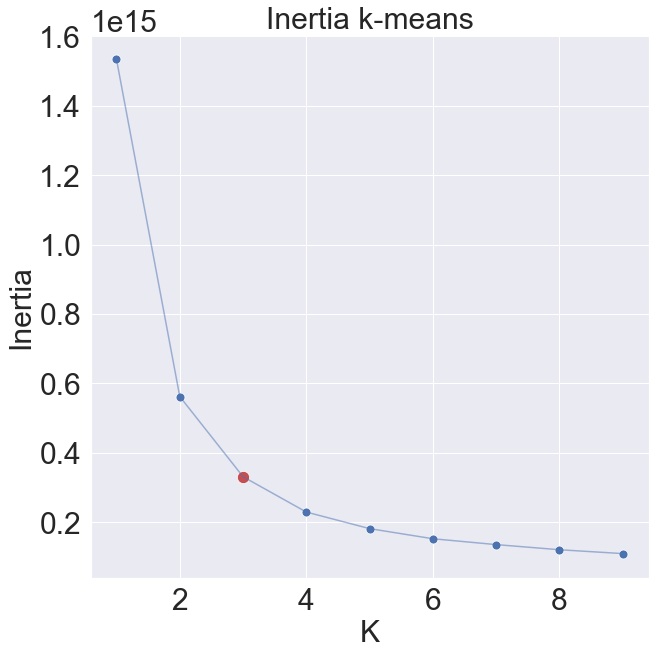

In [89]:
import matplotlib

matplotlib.rc('xtick', labelsize=30)     
matplotlib.rc('ytick', labelsize=30)

from sklearn.cluster import KMeans
import seaborn as sns
inertias = []
sns_c = sns.color_palette(palette='deep')
k_candidates = range(1, 10)

for k in k_candidates:
    k_means = KMeans(random_state=42, n_clusters=k)
    k_means.fit(xpca)
    inertias.append(k_means.inertia_)

fig, ax = plt.subplots(figsize=(10, 10))
sns.scatterplot(x=k_candidates, y = inertias, s=80, ax=ax)
sns.scatterplot(x=[k_candidates[2]], y = [inertias[2]], color=sns_c[3], s=150, ax=ax)
sns.lineplot(x=k_candidates, y = inertias, alpha=0.5, ax=ax)
ax.set_xlabel('K', fontsize = 30)
ax.set_ylabel('Inertia', fontsize = 30)
ax.set_title("Inertia k-means",fontsize = 30)

In [90]:
from sklearn.cluster import KMeans

In [91]:
pca.components_

array([[-5.89578866e-08,  2.16935871e-09, -7.19117535e-08,
         2.18974261e-06,  3.36592315e-01,  3.35446644e-01,
         3.25442889e-01,  3.03200280e-01,  2.82459175e-01,
         2.69348067e-01,  1.70343826e-02,  1.58664131e-02,
         1.44077460e-02,  1.18570799e-02,  1.18184384e-02,
         1.28124176e-02,  2.14380561e-07, -1.37230273e-06,
         3.19580231e-01,  3.11035143e-01,  2.91343200e-01,
         2.70640736e-01,  2.56535649e-01],
       [ 2.41761628e-07, -7.27148578e-07, -7.42122299e-09,
        -1.51180096e-06, -3.60938859e-01, -3.19770924e-01,
        -4.57910788e-02,  1.71414783e-01,  2.93167834e-01,
         3.39076685e-01,  2.33486229e-03,  1.53624858e-01,
         1.01364518e-01,  5.49706767e-02,  1.95219845e-02,
        -6.07871395e-02,  3.38549604e-06, -3.68198072e-08,
        -4.73395782e-01, -1.47155597e-01,  1.16444106e-01,
         2.73645849e-01,  3.99863824e-01]])

In [92]:
dfpca = pd.DataFrame(xpca)

In [93]:
dfpca.head()

,0,1
0,-6464.311629,14098.045162
1,-86085.723339,48549.293302
2,-100207.330100,-87788.432825
3,-4511.081192,2692.144451
4,-136280.258395,-1451.149116


In [94]:
dfpca.columns = ['Component_1','Component_2']
dfpca.head()

,Component_1,Component_2
0,-6464.311629,14098.045162
1,-86085.723339,48549.293302
2,-100207.330100,-87788.432825
3,-4511.081192,2692.144451
4,-136280.258395,-1451.149116


In [95]:
pca.explained_variance_ratio_

array([0.84239847, 0.05073774])

In [96]:
# Performing k means clustering
km = KMeans(
    n_clusters=3, init='random',
    n_init=10, max_iter=300, 
    tol=1e-04, random_state=0
)
km.fit(xpca)
y_km = km.fit_predict(xpca)

In [97]:
seg = km.labels_

In [98]:
centroids = km.cluster_centers_

In [99]:
print(centroids)

[[-8.68282479e+04  5.86643394e+01]
 [ 2.02890329e+05 -1.29877372e+03]
 [ 7.00344622e+05  4.53749998e+03]]


In [100]:
dfpca['Segment'] = pd.DataFrame(seg)

In [101]:
count = dfpca.groupby('Segment').count()

In [102]:
count

,Component_1,Component_2
Segment,,
0,27087,27087
1,6459,6459
2,1500,1500


In [103]:
dfpca['Segment1'] = dfpca['Segment'].map({0:'First',1:'Second',2:'Third'})

In [104]:
dfpca.head()

,Component_1,Component_2,Segment,Segment1
0,-6464.311629,14098.045162,0,First
1,-86085.723339,48549.293302,0,First
2,-100207.330100,-87788.432825,0,First
3,-4511.081192,2692.144451,0,First
4,-136280.258395,-1451.149116,0,First


##### Visualizing K-means clusters

In [105]:
import matplotlib     
matplotlib.rc('xtick', labelsize=30)     
matplotlib.rc('ytick', labelsize=30)

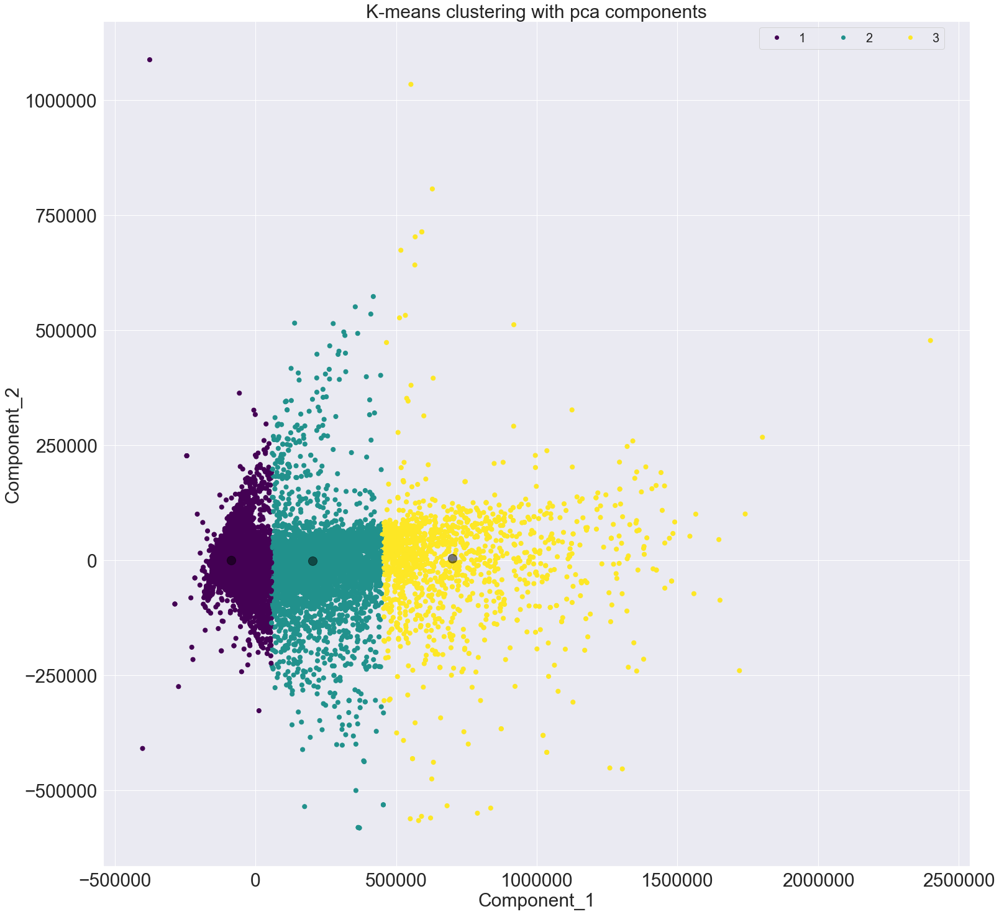

In [106]:
classes2 = ['1', '2', '3']
fig, ax = plt.subplots(figsize=(25,25))
scat = plt.scatter(dfpca['Component_1'], dfpca['Component_2'], c=y_km, s=50, cmap='viridis')
ax.set_xlabel('Component_1', fontsize = 30)
ax.set_ylabel('Component_2', fontsize = 30)
ax.set_title("K-means clustering with pca components",fontsize = 30)
plt.legend(handles=scat.legend_elements()[0], labels=classes2,loc='upper left', numpoints=1, ncol=3, fontsize=20, bbox_to_anchor=(0.75, 1.0))
centers = km.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5);

In [107]:
from sklearn.metrics import silhouette_score
score = silhouette_score(xpca, km.labels_, metric='euclidean')
#
# Print the score
#
print('Silhouetter Score: %.3f' % score)

Silhouetter Score: 0.666


In [108]:
## Centroids of the clusters
centersdf = pd.DataFrame(centers)
print(centersdf)

               0            1
0  -86828.247948    58.664339
1  202890.329064 -1298.773725
2  700344.621749  4537.499980


### Spectral clustering 

In multivariate statistics and the clustering of data, spectral clustering techniques make use of the spectrum (eigenvalues) of the similarity matrix of the data to perform dimensionality reduction before clustering in fewer dimensions. 

The similarity matrix is provided as an input and consists of a quantitative assessment of the relative similarity of each pair of points in the dataset.

In [109]:
# Scaling the Data 
from sklearn.preprocessing import StandardScaler, normalize 
scaler = StandardScaler() 
X_scaled = scaler.fit_transform(X) 
  
# Normalizing the Data 
X_normalized = normalize(X_scaled) 
  
# Converting the numpy array into a pandas DataFrame 
X_normalized = pd.DataFrame(X_normalized) 
  
# Reducing the dimensions of the data 
pcag = PCA(0.95) 
X_principal = pcag.fit_transform(X_normalized) 

In [110]:
pcag.explained_variance_ratio_

array([0.32821063, 0.16218964, 0.11967778, 0.09355516, 0.08329422,
       0.0602932 , 0.034086  , 0.02202769, 0.01717692, 0.01623992,
       0.01597908])

Text(0.5, 1.0, 'Spectral clustering of credit card data')

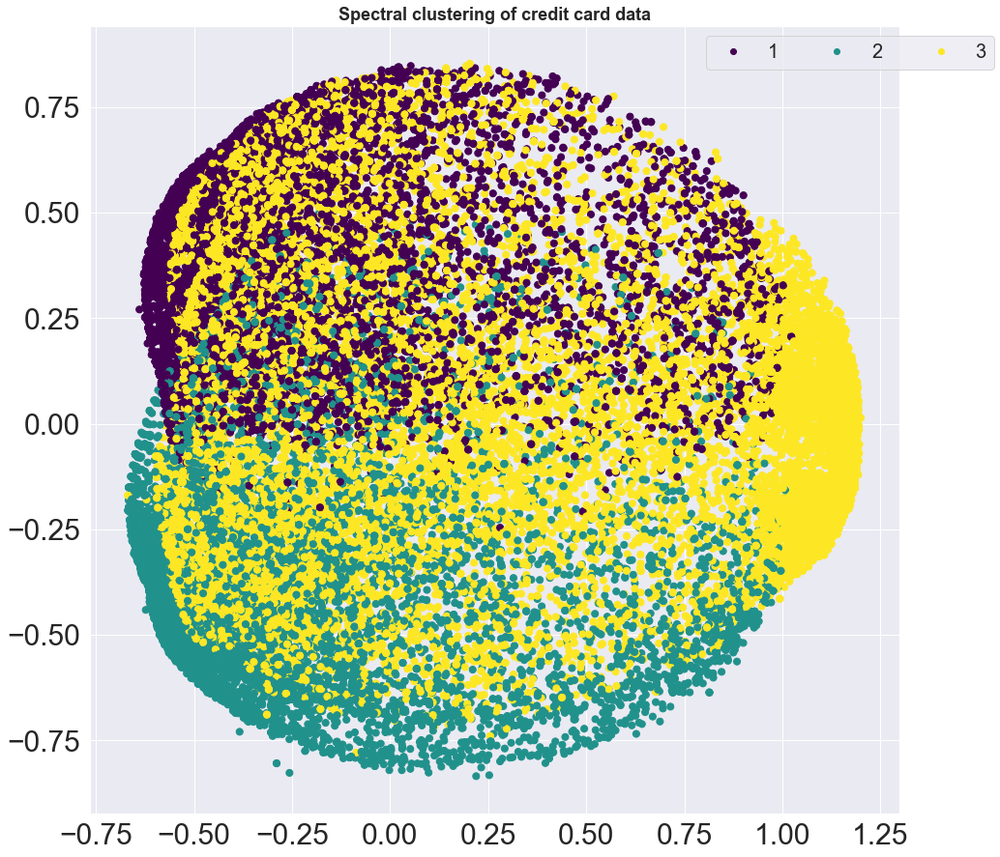

In [111]:
classes1 = ['1', '2', '3']
from sklearn.cluster import SpectralClustering
model = SpectralClustering(n_clusters=3, affinity='nearest_neighbors',
                          assign_labels='kmeans')
dot_size=50
cmap = 'viridis'
labelsS = model.fit_predict(X_principal)
fig, ax = plt.subplots(figsize=(15,15))
sc = plt.scatter(X_principal[:, 0], X_principal[:, 1], c=labelsS, s=dot_size, cmap=cmap)
plt.legend(handles=sc.legend_elements()[0], labels=classes1,loc='upper left', numpoints=1, ncol=3, fontsize=20, bbox_to_anchor=(0.75, 1.0))
ax.set_title('Spectral clustering of credit card data', fontsize=18, fontweight='demi')


In [112]:
# Calculating the silhoutte_score
s_scores = []
from sklearn.metrics import silhouette_samples, silhouette_score
s_scores.append(silhouette_score(X_principal, labelsS)) 
print(s_scores)

[0.1291381234138339]


### Clustering based on TSNE

t-Distributed Stochastic Neighbor Embedding (t-SNE) is an unsupervised, non-linear technique primarily used for data exploration and visualizing high-dimensional data. 
In simpler terms, t-SNE gives you a feel or intuition of how the data is arranged in a high-dimensional space.

In [113]:
from sklearn.manifold import TSNE
Xtsne = TSNE(perplexity=10).fit_transform(xpca)
dfnj = pd.DataFrame(Xtsne)

In [114]:
Xtsne

array([[-22.357336 , -49.86468  ],
       [ 74.663506 ,   1.8581989],
       [-29.479292 ,  -7.419928 ],
       ...,
       [-46.113064 ,  21.213642 ],
       [-45.230343 ,  24.615452 ],
       [ 23.744844 ,  76.85712  ]], dtype=float32)

In [115]:
dfnj.columns = ['x1','x2']

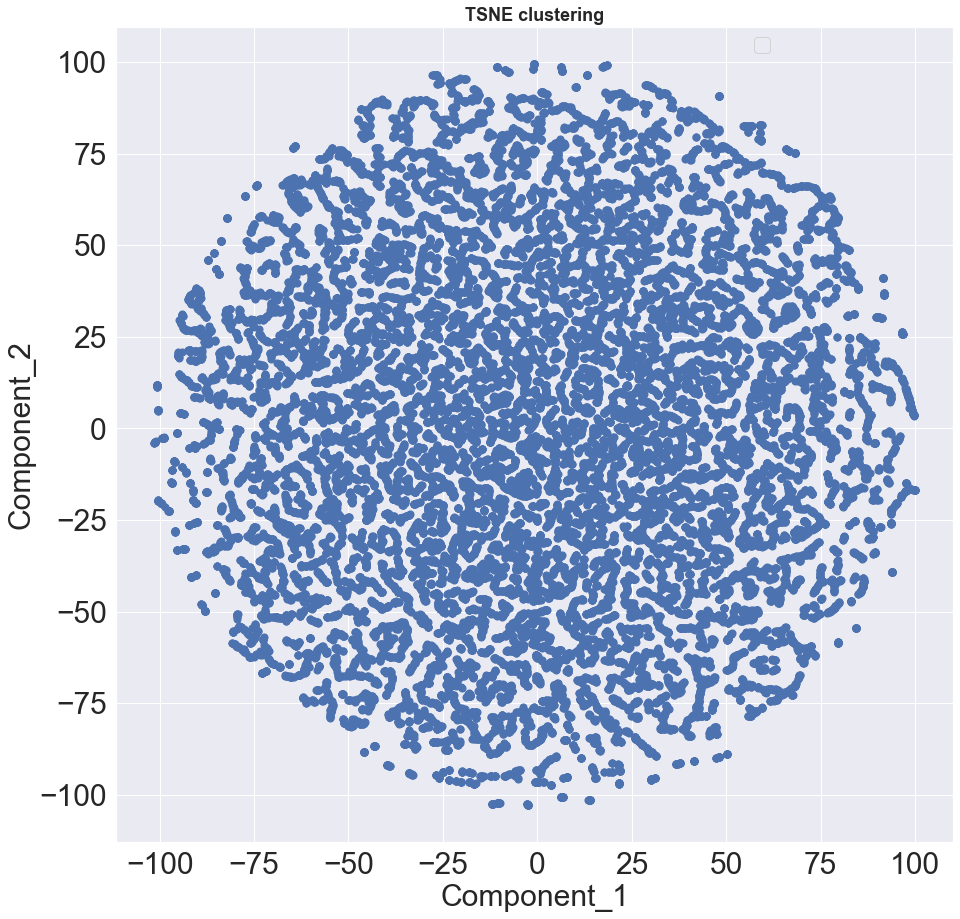

In [116]:
fig, ax = plt.subplots(figsize=(15,15))
ax.set_title('TSNE clustering', fontsize=18, fontweight='demi')
sc = plt.scatter(dfnj['x1'], dfnj['x2'], s=dot_size, cmap=cmap)
ax.set_xlabel('Component_1', fontsize = 30)
ax.set_ylabel('Component_2', fontsize = 30)
plt.legend(handles=sc.legend_elements()[0],loc='upper left', numpoints=1, ncol=3, fontsize=20, bbox_to_anchor=(0.75, 1.0))
plt.show()

### Conclusion

* It can be concluded that for the given credit card dataset, random forest algorithm works best for carrying out predictive analytics followed by decision tree classifier.
* The available dataset wasn’t efficient to carry out predictions, so new features had to be added to improve the efficiency of the models.
* Clustering analysis helped in understanding the behavior of data and thus drawing conclusions.
* Predictive analysis of the credit card defaulters is essential as it can help the financial institutions in dealing with such clients and in saving huge amounts. 


### References

1. https://towardsdatascience.com/k-means-clustering-with-scikit-learn-6b47a369a83c
2. https://365datascience.com/pca-k-means/
3. https://www.kdnuggets.com/2020/05/getting-started-spectral-clustering.html
4. https://www.kaggle.com/rpsuraj/classifying-credit-card-defaulters-deployment/notebook
5. https://towardsdatascience.com/building-a-logistic-regression-in-python-step-by-step-becd4d56c9c8
6. https://www.kdnuggets.com/2020/04/visualizing-decision-trees-python.html
7. https://towardsdatascience.com/support-vector-machine-introduction-to-machine-learning-algorithms-934a444fca47
8. https://machinelearningmastery.com/metrics-evaluate-machine-learning-algorithms-python/